## Dataset Link: https://www.kaggle.com/datasets/usdot/flight-delays/

### Import required libraries


In [2]:
import os
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

import joblib

In [3]:
df1 = pd.read_csv("flights.csv")

In [4]:
df1.columns

Index(['YEAR', 'MONTH', 'DAY', 'DAY_OF_WEEK', 'AIRLINE', 'FLIGHT_NUMBER',
       'TAIL_NUMBER', 'ORIGIN_AIRPORT', 'DESTINATION_AIRPORT',
       'SCHEDULED_DEPARTURE', 'DEPARTURE_TIME', 'DEPARTURE_DELAY', 'TAXI_OUT',
       'WHEELS_OFF', 'SCHEDULED_TIME', 'ELAPSED_TIME', 'AIR_TIME', 'DISTANCE',
       'WHEELS_ON', 'TAXI_IN', 'SCHEDULED_ARRIVAL', 'ARRIVAL_TIME',
       'ARRIVAL_DELAY', 'DIVERTED', 'CANCELLED', 'CANCELLATION_REASON',
       'AIR_SYSTEM_DELAY', 'SECURITY_DELAY', 'AIRLINE_DELAY',
       'LATE_AIRCRAFT_DELAY', 'WEATHER_DELAY'],
      dtype='object')

### Data description

In [5]:
pd.set_option('display.max_columns',None)
df1

,YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
0,2015,1,1,4,AS,98,N407AS,ANC,SEA,5,2354.0,-11.0,21.0,15.0,205.0,194.0,169.0,1448,404.0,4.0,430,408.0,-22.0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
1,2015,1,1,4,AA,2336,N3KUAA,LAX,PBI,10,2.0,-8.0,12.0,14.0,280.0,279.0,263.0,2330,737.0,4.0,750,741.0,-9.0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
2,2015,1,1,4,US,840,N171US,SFO,CLT,20,18.0,-2.0,16.0,34.0,286.0,293.0,266.0,2296,800.0,11.0,806,811.0,5.0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
3,2015,1,1,4,AA,258,N3HYAA,LAX,MIA,20,15.0,-5.0,15.0,30.0,285.0,281.0,258.0,2342,748.0,8.0,805,756.0,-9.0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,2015,1,1,4,AS,135,N527AS,SEA,ANC,25,24.0,-1.0,11.0,35.0,235.0,215.0,199.0,1448,254.0,5.0,320,259.0,-21.0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048570,2015,3,10,2,EV,4122,N11191,RDU,EWR,1013,1005.0,-8.0,17.0,1022.0,96.0,88.0,64.0,416,1126.0,7.0,1149,1133.0,-16.0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
1048571,2015,3,10,2,UA,1018,N79279,LGA,IAH,1013,1005.0,-8.0,40.0,1045.0,264.0,270.0,219.0,1416,1324.0,11.0,1337,1335.0,-2.0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
1048572,2015,3,10,2,UA,1260,N76508,SAN,ORD,1013,1010.0,-3.0,21.0,1031.0,251.0,257.0,220.0,1723,1611.0,16.0,1624,1627.0,3.0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
1048573,2015,3,10,2,EV,4349,N14158,MSY,ORD,1013,1003.0,-10.0,10.0,1013.0,149.0,146.0,127.0,837,1220.0,9.0,1242,1229.0,-13.0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 31 columns):
 #   Column               Non-Null Count    Dtype  
---  ------               --------------    -----  
 0   YEAR                 1048575 non-null  int64  
 1   MONTH                1048575 non-null  int64  
 2   DAY                  1048575 non-null  int64  
 3   DAY_OF_WEEK          1048575 non-null  int64  
 4   AIRLINE              1048575 non-null  object 
 5   FLIGHT_NUMBER        1048575 non-null  int64  
 6   TAIL_NUMBER          1040825 non-null  object 
 7   ORIGIN_AIRPORT       1048575 non-null  object 
 8   DESTINATION_AIRPORT  1048575 non-null  object 
 9   SCHEDULED_DEPARTURE  1048575 non-null  int64  
 10  DEPARTURE_TIME       1009060 non-null  float64
 11  DEPARTURE_DELAY      1009060 non-null  float64
 12  TAXI_OUT             1008346 non-null  float64
 13  WHEELS_OFF           1008346 non-null  float64
 14  SCHEDULED_TIME       1048573 non-null  float64
 15

In [7]:
pd.set_option('display.float_format', '{:.2f}'.format)

df1.describe()

,YEAR,MONTH,DAY,DAY_OF_WEEK,FLIGHT_NUMBER,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
count,1048575.00,1048575.00,1048575.00,1048575.00,1048575.00,1048575.00,1009060.00,1009060.00,1008346.00,1008346.00,1048573.00,1005504.00,1005504.00,1048575.00,1007279.00,1007279.00,1048575.00,1007279.00,1005504.00,1048575.00,1048575.00,228528.00,228528.00,228528.00,228528.00,228528.00
mean,2015.00,1.69,13.82,3.95,2256.76,1322.63,1333.70,11.33,16.65,1357.38,140.25,136.94,112.75,803.41,1485.93,7.55,1504.82,1492.20,7.61,0.00,0.04,13.69,0.06,18.20,22.92,3.55
std,0.00,0.71,8.73,2.00,1799.17,470.77,482.74,39.22,10.07,483.04,74.63,73.95,71.87,594.24,503.35,6.35,486.56,507.11,42.09,0.05,0.19,25.52,1.78,46.32,41.89,23.61
min,2015.00,1.00,1.00,1.00,1.00,1.00,1.00,-61.00,1.00,1.00,20.00,15.00,7.00,31.00,1.00,1.00,1.00,1.00,-82.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,2015.00,1.00,6.00,2.00,755.00,920.00,928.00,-5.00,11.00,944.00,85.00,82.00,60.00,368.00,1110.00,4.00,1120.00,1115.00,-12.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
50%,2015.00,2.00,13.00,4.00,1725.00,1319.00,1329.00,-1.00,14.00,1342.00,122.00,119.00,94.00,641.00,1516.00,6.00,1524.00,1521.00,-3.00,0.00,0.00,4.00,0.00,2.00,4.00,0.00
75%,2015.00,2.00,21.00,6.00,3485.00,1720.00,1731.00,11.00,19.00,1745.00,173.00,169.00,144.00,1046.00,1911.00,9.00,1915.00,1917.00,12.00,0.00,0.00,19.00,0.00,18.00,29.00,0.00
max,2015.00,3.00,31.00,7.00,9794.00,2359.00,2400.00,1988.00,225.00,2400.00,718.00,766.00,687.00,4983.00,2400.00,202.00,2359.00,2400.00,1971.00,1.00,1.00,830.00,241.00,1971.00,1313.00,1152.00


### Checking no.of delayed flights


In [8]:
(df1['DEPARTURE_DELAY'] > 15).value_counts()

DEPARTURE_DELAY
False    837164
True     211411
Name: count, dtype: int64

In [9]:
(df1['ARRIVAL_DELAY'] > 15).value_counts()

ARRIVAL_DELAY
False    828158
True     220417
Name: count, dtype: int64

### Null values


In [10]:
df1.isnull().sum()

YEAR                         0
MONTH                        0
DAY                          0
DAY_OF_WEEK                  0
AIRLINE                      0
FLIGHT_NUMBER                0
TAIL_NUMBER               7750
ORIGIN_AIRPORT               0
DESTINATION_AIRPORT          0
SCHEDULED_DEPARTURE          0
DEPARTURE_TIME           39515
DEPARTURE_DELAY          39515
TAXI_OUT                 40229
WHEELS_OFF               40229
SCHEDULED_TIME               2
ELAPSED_TIME             43071
AIR_TIME                 43071
DISTANCE                     0
WHEELS_ON                41296
TAXI_IN                  41296
SCHEDULED_ARRIVAL            0
ARRIVAL_TIME             41296
ARRIVAL_DELAY            43071
DIVERTED                     0
CANCELLED                    0
CANCELLATION_REASON    1008048
AIR_SYSTEM_DELAY        820047
SECURITY_DELAY          820047
AIRLINE_DELAY           820047
LATE_AIRCRAFT_DELAY     820047
WEATHER_DELAY           820047
dtype: int64

In [11]:
null_columns = df1.columns[df1.isnull().any()]
null_columns


Index(['TAIL_NUMBER', 'DEPARTURE_TIME', 'DEPARTURE_DELAY', 'TAXI_OUT',
       'WHEELS_OFF', 'SCHEDULED_TIME', 'ELAPSED_TIME', 'AIR_TIME', 'WHEELS_ON',
       'TAXI_IN', 'ARRIVAL_TIME', 'ARRIVAL_DELAY', 'CANCELLATION_REASON',
       'AIR_SYSTEM_DELAY', 'SECURITY_DELAY', 'AIRLINE_DELAY',
       'LATE_AIRCRAFT_DELAY', 'WEATHER_DELAY'],
      dtype='object')

### Null departure time


In [12]:
pd.set_option('display.max_columns',None)
rows_with_null_dep_time = df1[df1['DEPARTURE_TIME'].isnull()]
rows_with_null_dep_time


,YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
32,2015,1,1,4,AS,136,N431AS,ANC,SEA,135,NaN,NaN,NaN,NaN,205.00,NaN,NaN,1448,NaN,NaN,600,NaN,NaN,0,1,A,NaN,NaN,NaN,NaN,NaN
42,2015,1,1,4,AA,2459,N3BDAA,PHX,DFW,200,NaN,NaN,NaN,NaN,120.00,NaN,NaN,868,NaN,NaN,500,NaN,NaN,0,1,B,NaN,NaN,NaN,NaN,NaN
68,2015,1,1,4,OO,5254,N746SK,MAF,IAH,510,NaN,NaN,NaN,NaN,87.00,NaN,NaN,429,NaN,NaN,637,NaN,NaN,0,1,B,NaN,NaN,NaN,NaN,NaN
82,2015,1,1,4,MQ,2859,N660MQ,SGF,DFW,525,NaN,NaN,NaN,NaN,95.00,NaN,NaN,364,NaN,NaN,700,NaN,NaN,0,1,B,NaN,NaN,NaN,NaN,NaN
90,2015,1,1,4,OO,5460,N583SW,RDD,SFO,530,NaN,NaN,NaN,NaN,90.00,NaN,NaN,199,NaN,NaN,700,NaN,NaN,0,1,A,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048125,2015,3,10,2,MQ,3200,N9EAMQ,AMA,DFW,948,NaN,NaN,NaN,NaN,71.00,NaN,NaN,312,NaN,NaN,1059,NaN,NaN,0,1,A,NaN,NaN,NaN,NaN,NaN
1048364,2015,3,10,2,WN,3836,N8323C,MDW,DAL,1000,NaN,NaN,NaN,NaN,140.00,NaN,NaN,793,NaN,NaN,1220,NaN,NaN,0,1,B,NaN,NaN,NaN,NaN,NaN
1048431,2015,3,10,2,EV,2527,N902EV,DFW,MOB,1005,NaN,NaN,NaN,NaN,90.00,NaN,NaN,539,NaN,NaN,1135,NaN,NaN,0,1,A,NaN,NaN,NaN,NaN,NaN
1048470,2015,3,10,2,MQ,3672,N624MQ,ORD,DBQ,1005,NaN,NaN,NaN,NaN,50.00,NaN,NaN,147,NaN,NaN,1055,NaN,NaN,0,1,B,NaN,NaN,NaN,NaN,NaN


=> departure time is not available for cancelled flights and diverted flights

### Cancelled flights

In [13]:
df1['CANCELLED'].value_counts()


CANCELLED
0    1008048
1      40527
Name: count, dtype: int64

In [14]:
df1['CANCELLATION_REASON'].value_counts()

CANCELLATION_REASON
B    28260
A     6974
C     5291
D        2
Name: count, dtype: int64

In [15]:
pd.set_option('display.max_columns', None)
cancelled_flights = df1[df1['CANCELLED'] == 1]
cancelled_flights


,YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
32,2015,1,1,4,AS,136,N431AS,ANC,SEA,135,NaN,NaN,NaN,NaN,205.00,NaN,NaN,1448,NaN,NaN,600,NaN,NaN,0,1,A,NaN,NaN,NaN,NaN,NaN
42,2015,1,1,4,AA,2459,N3BDAA,PHX,DFW,200,NaN,NaN,NaN,NaN,120.00,NaN,NaN,868,NaN,NaN,500,NaN,NaN,0,1,B,NaN,NaN,NaN,NaN,NaN
68,2015,1,1,4,OO,5254,N746SK,MAF,IAH,510,NaN,NaN,NaN,NaN,87.00,NaN,NaN,429,NaN,NaN,637,NaN,NaN,0,1,B,NaN,NaN,NaN,NaN,NaN
82,2015,1,1,4,MQ,2859,N660MQ,SGF,DFW,525,NaN,NaN,NaN,NaN,95.00,NaN,NaN,364,NaN,NaN,700,NaN,NaN,0,1,B,NaN,NaN,NaN,NaN,NaN
90,2015,1,1,4,OO,5460,N583SW,RDD,SFO,530,NaN,NaN,NaN,NaN,90.00,NaN,NaN,199,NaN,NaN,700,NaN,NaN,0,1,A,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048364,2015,3,10,2,WN,3836,N8323C,MDW,DAL,1000,NaN,NaN,NaN,NaN,140.00,NaN,NaN,793,NaN,NaN,1220,NaN,NaN,0,1,B,NaN,NaN,NaN,NaN,NaN
1048431,2015,3,10,2,EV,2527,N902EV,DFW,MOB,1005,NaN,NaN,NaN,NaN,90.00,NaN,NaN,539,NaN,NaN,1135,NaN,NaN,0,1,A,NaN,NaN,NaN,NaN,NaN
1048460,2015,3,10,2,EV,4943,N612QX,MSP,CLE,1005,1029.00,24.00,NaN,NaN,116.00,NaN,NaN,622,NaN,NaN,1301,NaN,NaN,0,1,A,NaN,NaN,NaN,NaN,NaN
1048470,2015,3,10,2,MQ,3672,N624MQ,ORD,DBQ,1005,NaN,NaN,NaN,NaN,50.00,NaN,NaN,147,NaN,NaN,1055,NaN,NaN,0,1,B,NaN,NaN,NaN,NaN,NaN


=> Cancelled flights do not contribute to delayed flight

#### Creating new dataframe without cancelled flights

In [16]:
df2 = df1[df1['CANCELLED'] == 0]
df2

,YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
0,2015,1,1,4,AS,98,N407AS,ANC,SEA,5,2354.00,-11.00,21.00,15.00,205.00,194.00,169.00,1448,404.00,4.00,430,408.00,-22.00,0,0,NaN,NaN,NaN,NaN,NaN,NaN
1,2015,1,1,4,AA,2336,N3KUAA,LAX,PBI,10,2.00,-8.00,12.00,14.00,280.00,279.00,263.00,2330,737.00,4.00,750,741.00,-9.00,0,0,NaN,NaN,NaN,NaN,NaN,NaN
2,2015,1,1,4,US,840,N171US,SFO,CLT,20,18.00,-2.00,16.00,34.00,286.00,293.00,266.00,2296,800.00,11.00,806,811.00,5.00,0,0,NaN,NaN,NaN,NaN,NaN,NaN
3,2015,1,1,4,AA,258,N3HYAA,LAX,MIA,20,15.00,-5.00,15.00,30.00,285.00,281.00,258.00,2342,748.00,8.00,805,756.00,-9.00,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,2015,1,1,4,AS,135,N527AS,SEA,ANC,25,24.00,-1.00,11.00,35.00,235.00,215.00,199.00,1448,254.00,5.00,320,259.00,-21.00,0,0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048569,2015,3,10,2,DL,1546,N555NW,PHX,ATL,1013,1045.00,32.00,15.00,1100.00,217.00,204.00,183.00,1587,1703.00,6.00,1650,1709.00,19.00,0,0,NaN,0.00,0.00,0.00,19.00,0.00
1048570,2015,3,10,2,EV,4122,N11191,RDU,EWR,1013,1005.00,-8.00,17.00,1022.00,96.00,88.00,64.00,416,1126.00,7.00,1149,1133.00,-16.00,0,0,NaN,NaN,NaN,NaN,NaN,NaN
1048571,2015,3,10,2,UA,1018,N79279,LGA,IAH,1013,1005.00,-8.00,40.00,1045.00,264.00,270.00,219.00,1416,1324.00,11.00,1337,1335.00,-2.00,0,0,NaN,NaN,NaN,NaN,NaN,NaN
1048572,2015,3,10,2,UA,1260,N76508,SAN,ORD,1013,1010.00,-3.00,21.00,1031.00,251.00,257.00,220.00,1723,1611.00,16.00,1624,1627.00,3.00,0,0,NaN,NaN,NaN,NaN,NaN,NaN


In [17]:
df2.isnull().sum()

YEAR                         0
MONTH                        0
DAY                          0
DAY_OF_WEEK                  0
AIRLINE                      0
FLIGHT_NUMBER                0
TAIL_NUMBER                  0
ORIGIN_AIRPORT               0
DESTINATION_AIRPORT          0
SCHEDULED_DEPARTURE          0
DEPARTURE_TIME               0
DEPARTURE_DELAY              0
TAXI_OUT                     0
WHEELS_OFF                   0
SCHEDULED_TIME               0
ELAPSED_TIME              2544
AIR_TIME                  2544
DISTANCE                     0
WHEELS_ON                  769
TAXI_IN                    769
SCHEDULED_ARRIVAL            0
ARRIVAL_TIME               769
ARRIVAL_DELAY             2544
DIVERTED                     0
CANCELLED                    0
CANCELLATION_REASON    1008048
AIR_SYSTEM_DELAY        779520
SECURITY_DELAY          779520
AIRLINE_DELAY           779520
LATE_AIRCRAFT_DELAY     779520
WEATHER_DELAY           779520
dtype: int64

### Dropping Cancellation Reason column

In [18]:
df2 = df2.drop(columns=['CANCELLATION_REASON'])

=> Dropping it since cancelled flights were already dropped 

### Analysing the reason for other null values

In [19]:
pd.set_option('display.max_columns',None)
rows_with_null_arr_time = df2[df2['ARRIVAL_TIME'].isnull()]
rows_with_null_arr_time


,YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
4639,2015,1,1,4,EV,4654,N29515,IAH,HRL,1125,1206.00,41.00,11.00,1217.00,75.00,NaN,NaN,295,NaN,NaN,1240,NaN,NaN,1,0,NaN,NaN,NaN,NaN,NaN
7281,2015,1,1,4,EV,4654,N14543,CRP,HRL,1410,1736.00,206.00,9.00,1745.00,32.00,NaN,NaN,107,NaN,NaN,1442,NaN,NaN,1,0,NaN,NaN,NaN,NaN,NaN
7508,2015,1,1,4,OO,5488,N791SK,IAH,ASE,1427,1436.00,9.00,19.00,1455.00,172.00,NaN,NaN,913,NaN,NaN,1619,NaN,NaN,1,0,NaN,NaN,NaN,NaN,NaN
11120,2015,1,1,4,OO,5203,N774SK,LAX,ASE,1816,1840.00,24.00,22.00,1902.00,128.00,NaN,NaN,737,NaN,NaN,2124,NaN,NaN,1,0,NaN,NaN,NaN,NaN,NaN
17275,2015,1,2,5,EV,2548,N905EV,DFW,BTR,830,824.00,-6.00,36.00,900.00,80.00,NaN,NaN,383,NaN,NaN,950,NaN,NaN,1,0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1038516,2015,3,9,1,OO,4587,N611SK,SLC,SUN,1650,1642.00,-8.00,18.00,1700.00,63.00,NaN,NaN,222,NaN,NaN,1753,NaN,NaN,1,0,NaN,NaN,NaN,NaN,NaN
1039244,2015,3,9,1,MQ,2922,N932MQ,DFW,CMI,1730,1811.00,41.00,23.00,1834.00,113.00,NaN,NaN,693,NaN,NaN,1923,NaN,NaN,1,0,NaN,NaN,NaN,NaN,NaN
1042018,2015,3,9,1,AS,51,N797AS,BRW,SCC,2019,2005.00,-14.00,8.00,2013.00,44.00,NaN,NaN,204,NaN,NaN,2103,NaN,NaN,1,0,NaN,NaN,NaN,NaN,NaN
1042487,2015,3,9,1,AA,2298,N3AHAA,MIA,LGA,2100,2204.00,64.00,23.00,2227.00,169.00,NaN,NaN,1096,NaN,NaN,2349,NaN,NaN,1,0,NaN,NaN,NaN,NaN,NaN


### Dropping Arrival_Time rows with null values

In [20]:
df2.dropna(subset=['ARRIVAL_TIME'], inplace=True)

In [21]:
df2.isnull().sum()

YEAR                        0
MONTH                       0
DAY                         0
DAY_OF_WEEK                 0
AIRLINE                     0
FLIGHT_NUMBER               0
TAIL_NUMBER                 0
ORIGIN_AIRPORT              0
DESTINATION_AIRPORT         0
SCHEDULED_DEPARTURE         0
DEPARTURE_TIME              0
DEPARTURE_DELAY             0
TAXI_OUT                    0
WHEELS_OFF                  0
SCHEDULED_TIME              0
ELAPSED_TIME             1775
AIR_TIME                 1775
DISTANCE                    0
WHEELS_ON                   0
TAXI_IN                     0
SCHEDULED_ARRIVAL           0
ARRIVAL_TIME                0
ARRIVAL_DELAY            1775
DIVERTED                    0
CANCELLED                   0
AIR_SYSTEM_DELAY       778751
SECURITY_DELAY         778751
AIRLINE_DELAY          778751
LATE_AIRCRAFT_DELAY    778751
WEATHER_DELAY          778751
dtype: int64

### Number of Airports


In [22]:
df1['ORIGIN_AIRPORT'].nunique()

315

In [23]:
df1['DESTINATION_AIRPORT'].nunique()

315

=> 315 different airports

In [24]:
df2['AIRLINE'].nunique()

14

=> 14 different airlines

In [25]:
pd.set_option('display.max_columns',None)
diverted_flights = df2[df2['DIVERTED']==1]
diverted_flights


,YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
724,2015,1,1,4,DL,716,N944DL,OMA,ATL,645,637.00,-8.00,27.00,704.00,144.00,NaN,NaN,821,1447.00,4.00,1009,1451.00,NaN,1,0,NaN,NaN,NaN,NaN,NaN
1455,2015,1,1,4,OO,5237,N712SK,MKE,IAH,745,742.00,-3.00,15.00,757.00,176.00,NaN,NaN,984,1456.00,9.00,1041,1505.00,NaN,1,0,NaN,NaN,NaN,NaN,NaN
2218,2015,1,1,4,WN,1966,N685SW,ATL,JAX,845,922.00,37.00,9.00,931.00,75.00,NaN,NaN,270,1214.00,5.00,1000,1219.00,NaN,1,0,NaN,NaN,NaN,NaN,NaN
2526,2015,1,1,4,EV,4555,N12552,IAH,HRL,902,859.00,-3.00,33.00,932.00,75.00,NaN,NaN,295,1314.00,5.00,1017,1319.00,NaN,1,0,NaN,NaN,NaN,NaN,NaN
2866,2015,1,1,4,WN,1081,N214WN,MDW,OKC,930,926.00,-4.00,9.00,935.00,125.00,NaN,NaN,691,1340.00,3.00,1135,1343.00,NaN,1,0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045541,2015,3,10,2,OO,5441,N576SW,SFO,SBP,714,713.00,-1.00,18.00,731.00,67.00,NaN,NaN,190,1057.00,4.00,821,1101.00,NaN,1,0,NaN,NaN,NaN,NaN,NaN
1047083,2015,3,10,2,EV,3950,N14977,ORD,GRB,845,839.00,-6.00,27.00,906.00,60.00,NaN,NaN,173,1106.00,3.00,945,1109.00,NaN,1,0,NaN,NaN,NaN,NaN,NaN
1047415,2015,3,10,2,EV,4591,N19554,IAH,LRD,900,854.00,-6.00,11.00,905.00,75.00,NaN,NaN,301,1149.00,5.00,1015,1154.00,NaN,1,0,NaN,NaN,NaN,NaN,NaN
1047945,2015,3,10,2,HA,47,N580HA,OAK,HNL,935,928.00,-7.00,15.00,943.00,340.00,NaN,NaN,2409,1740.00,4.00,1215,1744.00,NaN,1,0,NaN,NaN,NaN,NaN,NaN


=> Analyzed and found out that the rest of the null values were because of diverted flights


### Filtering the diverted flights from the dataset

In [26]:
df2 = df2[df2['DIVERTED'] != 1]


In [27]:
df2.isnull().sum()

YEAR                        0
MONTH                       0
DAY                         0
DAY_OF_WEEK                 0
AIRLINE                     0
FLIGHT_NUMBER               0
TAIL_NUMBER                 0
ORIGIN_AIRPORT              0
DESTINATION_AIRPORT         0
SCHEDULED_DEPARTURE         0
DEPARTURE_TIME              0
DEPARTURE_DELAY             0
TAXI_OUT                    0
WHEELS_OFF                  0
SCHEDULED_TIME              0
ELAPSED_TIME                0
AIR_TIME                    0
DISTANCE                    0
WHEELS_ON                   0
TAXI_IN                     0
SCHEDULED_ARRIVAL           0
ARRIVAL_TIME                0
ARRIVAL_DELAY               0
DIVERTED                    0
CANCELLED                   0
AIR_SYSTEM_DELAY       776976
SECURITY_DELAY         776976
AIRLINE_DELAY          776976
LATE_AIRCRAFT_DELAY    776976
WEATHER_DELAY          776976
dtype: int64

In [28]:
df2[df2['ARRIVAL_DELAY']>15]

,YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
27,2015,1,1,4,NK,597,N528NK,MSP,FLL,115,127.00,12.00,14.00,141.00,207.00,220.00,166.00,1487,527.00,40.00,542,607.00,25.00,0,0,25.00,0.00,0.00,0.00,0.00
30,2015,1,1,4,NK,168,N629NK,PHX,ORD,125,237.00,72.00,9.00,246.00,204.00,175.00,156.00,1440,622.00,10.00,549,632.00,43.00,0,0,43.00,0.00,0.00,0.00,0.00
50,2015,1,1,4,B6,1030,N239JB,BQN,MCO,307,304.00,-3.00,25.00,329.00,173.00,196.00,160.00,1129,509.00,11.00,500,520.00,20.00,0,0,20.00,0.00,0.00,0.00,0.00
52,2015,1,1,4,B6,2134,N307JB,SJU,MCO,400,535.00,95.00,9.00,544.00,185.00,175.00,163.00,1189,727.00,3.00,605,730.00,85.00,0,0,0.00,0.00,85.00,0.00,0.00
55,2015,1,1,4,B6,2276,N646JB,SJU,BDL,438,550.00,72.00,15.00,605.00,241.00,258.00,237.00,1666,902.00,6.00,739,908.00,89.00,0,0,17.00,0.00,72.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048543,2015,3,10,2,EV,2509,N901EV,DFW,GGG,1010,1106.00,56.00,17.00,1123.00,47.00,53.00,33.00,140,1156.00,3.00,1057,1159.00,62.00,0,0,6.00,0.00,35.00,21.00,0.00
1048552,2015,3,10,2,OO,6249,N771SK,LAS,SFO,1010,1109.00,59.00,12.00,1121.00,103.00,91.00,75.00,414,1236.00,4.00,1153,1240.00,47.00,0,0,47.00,0.00,0.00,0.00,0.00
1048559,2015,3,10,2,OO,6300,N564SW,LAX,PSP,1011,1043.00,32.00,28.00,1111.00,63.00,73.00,36.00,110,1147.00,9.00,1114,1156.00,42.00,0,0,10.00,0.00,7.00,25.00,0.00
1048561,2015,3,10,2,DL,1117,N586NW,MSP,RSW,1012,1047.00,35.00,9.00,1056.00,202.00,183.00,169.00,1416,1445.00,5.00,1434,1450.00,16.00,0,0,0.00,0.00,16.00,0.00,0.00


=> columns with cause of delay have values when arrival delay is greater than 15, otherwise they are NaN (This was deduced by observation and from the fact that there are 776976 rows in arrival_delay<15 and also 776976 null values in other rows)

### Observing the columns representing cause of delay

In [29]:
selected_columns = ['ARRIVAL_DELAY','AIR_SYSTEM_DELAY', 'SECURITY_DELAY', 'AIRLINE_DELAY', 'LATE_AIRCRAFT_DELAY', 'WEATHER_DELAY']

filtered_df = df2[df2['ARRIVAL_DELAY'] > 15][selected_columns]
print(filtered_df.to_string(index=False))


 ARRIVAL_DELAY  AIR_SYSTEM_DELAY  SECURITY_DELAY  AIRLINE_DELAY  LATE_AIRCRAFT_DELAY  WEATHER_DELAY
         25.00             25.00            0.00           0.00                 0.00           0.00
         43.00             43.00            0.00           0.00                 0.00           0.00
         20.00             20.00            0.00           0.00                 0.00           0.00
         85.00              0.00            0.00          85.00                 0.00           0.00
         89.00             17.00            0.00          72.00                 0.00           0.00
        102.00              0.00            0.00           0.00                 0.00         102.00
         60.00              0.00            0.00          60.00                 0.00           0.00
         54.00              0.00            0.00          54.00                 0.00           0.00
         66.00             13.00            0.00          53.00                 0.00           0.00


=> Deducing that imputing NaN values with 0 should be considered in rows where Arrival_Delay<15.

In [30]:
delay_columns = ['AIR_SYSTEM_DELAY', 'SECURITY_DELAY', 'AIRLINE_DELAY', 'LATE_AIRCRAFT_DELAY', 'WEATHER_DELAY']

for column in delay_columns:
    df2[column].fillna(0, inplace=True)

In [31]:
df2.isnull().sum()

YEAR                   0
MONTH                  0
DAY                    0
DAY_OF_WEEK            0
AIRLINE                0
FLIGHT_NUMBER          0
TAIL_NUMBER            0
ORIGIN_AIRPORT         0
DESTINATION_AIRPORT    0
SCHEDULED_DEPARTURE    0
DEPARTURE_TIME         0
DEPARTURE_DELAY        0
TAXI_OUT               0
WHEELS_OFF             0
SCHEDULED_TIME         0
ELAPSED_TIME           0
AIR_TIME               0
DISTANCE               0
WHEELS_ON              0
TAXI_IN                0
SCHEDULED_ARRIVAL      0
ARRIVAL_TIME           0
ARRIVAL_DELAY          0
DIVERTED               0
CANCELLED              0
AIR_SYSTEM_DELAY       0
SECURITY_DELAY         0
AIRLINE_DELAY          0
LATE_AIRCRAFT_DELAY    0
WEATHER_DELAY          0
dtype: int64

=> Removed all the null values successfully

### Histograms

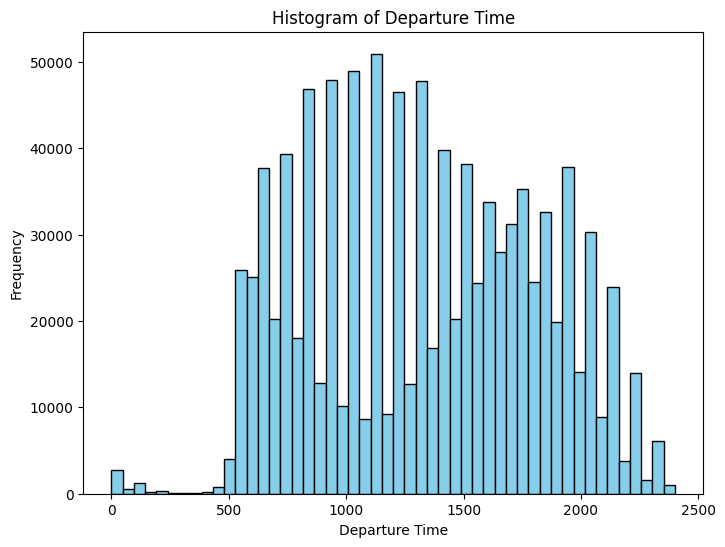

In [32]:
plt.figure(figsize=(8, 6))
plt.hist(df2['DEPARTURE_TIME'], bins=50, color='skyblue', edgecolor='black')
plt.title('Histogram of Departure Time')
plt.xlabel('Departure Time')
plt.ylabel('Frequency')
plt.show()

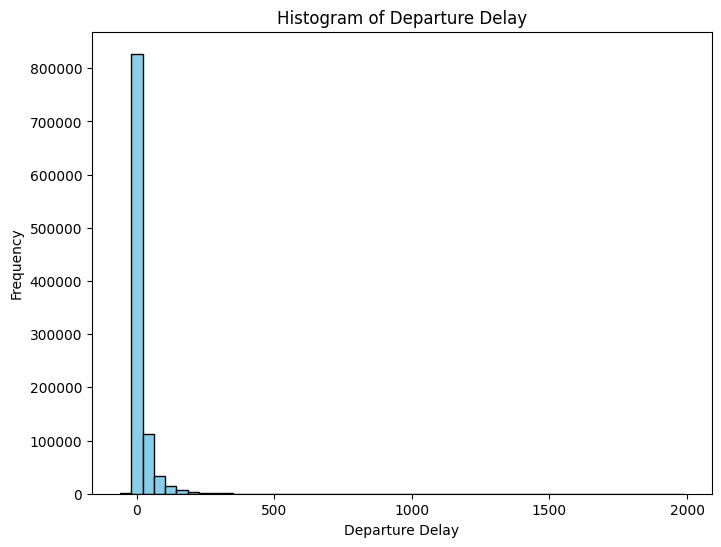

In [33]:
plt.figure(figsize=(8, 6))
plt.hist(df2['DEPARTURE_DELAY'], bins=50, color='skyblue', edgecolor='black')
plt.title('Histogram of Departure Delay')
plt.xlabel('Departure Delay')
plt.ylabel('Frequency')
plt.show()

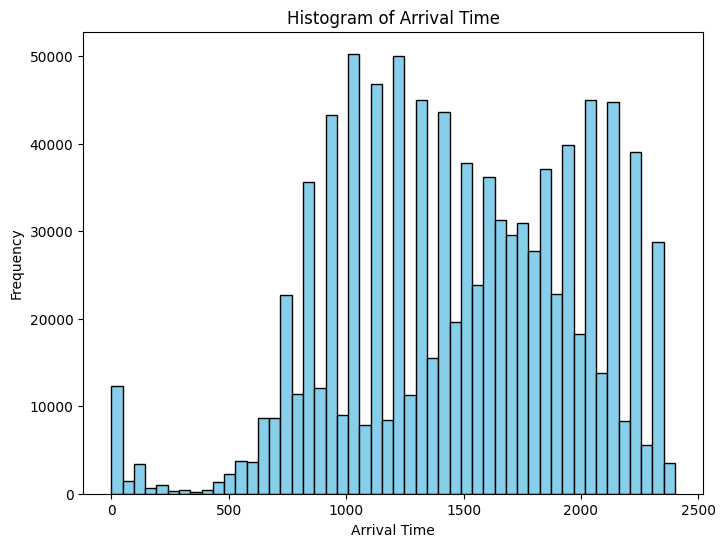

In [34]:
plt.figure(figsize=(8, 6))
plt.hist(df2['ARRIVAL_TIME'], bins=50, color='skyblue', edgecolor='black')
plt.title('Histogram of Arrival Time')
plt.xlabel('Arrival Time')
plt.ylabel('Frequency')
plt.show()

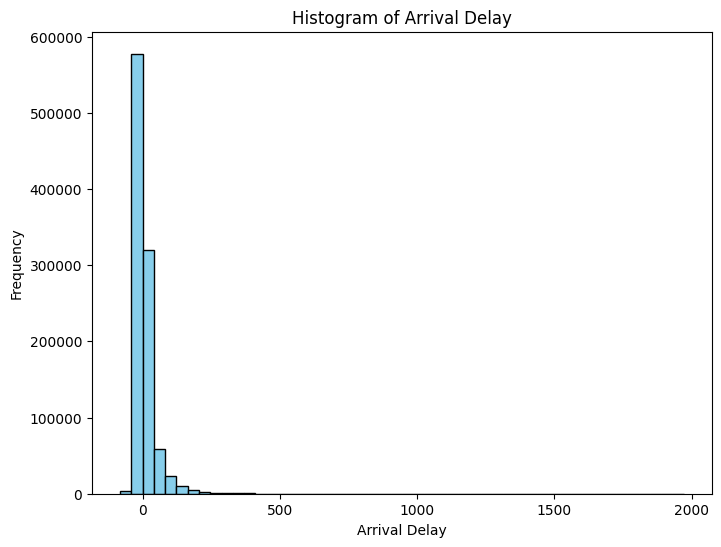

In [35]:
plt.figure(figsize=(8, 6))
plt.hist(df2['ARRIVAL_DELAY'], bins=50, color='skyblue', edgecolor='black')
plt.title('Histogram of Arrival Delay')
plt.xlabel('Arrival Delay')
plt.ylabel('Frequency')
plt.show()

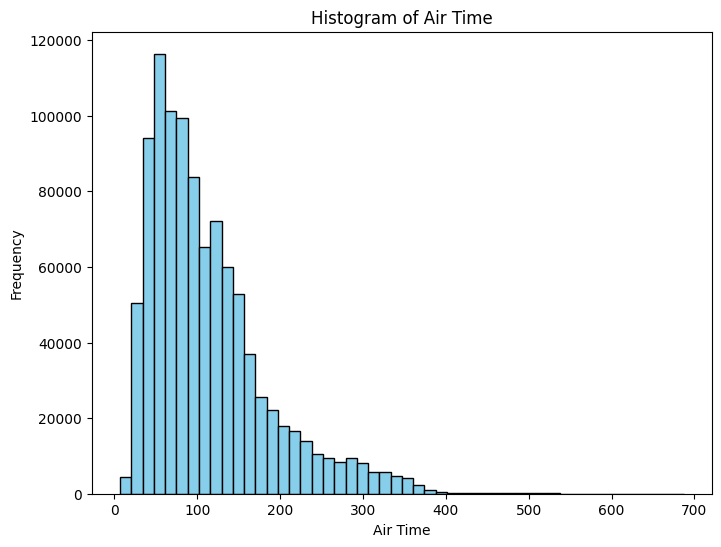

In [36]:
plt.figure(figsize=(8, 6))
plt.hist(df2['AIR_TIME'], bins=50, color='skyblue', edgecolor='black')
plt.title('Histogram of Air Time')
plt.xlabel('Air Time')
plt.ylabel('Frequency')
plt.show()

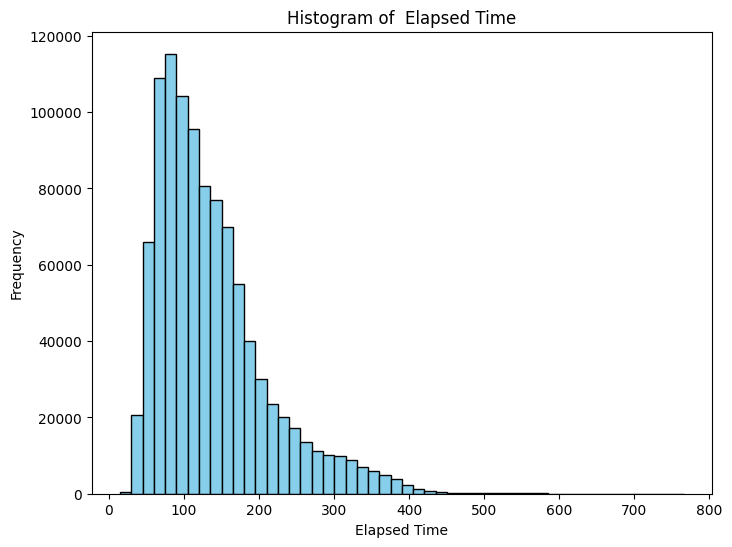

In [37]:
plt.figure(figsize=(8, 6))
plt.hist(df2['ELAPSED_TIME'], bins=50, color='skyblue', edgecolor='black')
plt.title('Histogram of  Elapsed Time')
plt.xlabel('Elapsed Time')
plt.ylabel('Frequency')
plt.show()

### Density plot for distance travelled


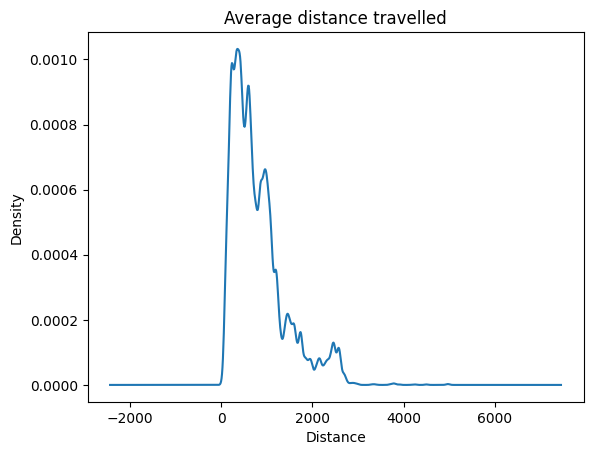

In [38]:
ax = df2['DISTANCE'].plot(kind='kde',
                          title='Average distance travelled')   # Density plot
ax.set_xlabel('Distance')
plt.show()


In [39]:
df2.head()

,YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
0,2015,1,1,4,AS,98,N407AS,ANC,SEA,5,2354.00,-11.00,21.00,15.00,205.00,194.00,169.00,1448,404.00,4.00,430,408.00,-22.00,0,0,0.00,0.00,0.00,0.00,0.00
1,2015,1,1,4,AA,2336,N3KUAA,LAX,PBI,10,2.00,-8.00,12.00,14.00,280.00,279.00,263.00,2330,737.00,4.00,750,741.00,-9.00,0,0,0.00,0.00,0.00,0.00,0.00
2,2015,1,1,4,US,840,N171US,SFO,CLT,20,18.00,-2.00,16.00,34.00,286.00,293.00,266.00,2296,800.00,11.00,806,811.00,5.00,0,0,0.00,0.00,0.00,0.00,0.00
3,2015,1,1,4,AA,258,N3HYAA,LAX,MIA,20,15.00,-5.00,15.00,30.00,285.00,281.00,258.00,2342,748.00,8.00,805,756.00,-9.00,0,0,0.00,0.00,0.00,0.00,0.00
4,2015,1,1,4,AS,135,N527AS,SEA,ANC,25,24.00,-1.00,11.00,35.00,235.00,215.00,199.00,1448,254.00,5.00,320,259.00,-21.00,0,0,0.00,0.00,0.00,0.00,0.00


### Dropping categorical columns (new dataframe)

In [40]:
df3 = df2.drop(['AIRLINE', 'TAIL_NUMBER', 'ORIGIN_AIRPORT', 'DESTINATION_AIRPORT'], axis=1)

### Preparation for model training

In [41]:
# Transforming DEPARTURE_DELAY into a binary target variable
y_binary = df3['DEPARTURE_DELAY'].apply(lambda x: 1 if x > 15 else 0)
y_binary = y_binary.rename('Delay')

# Splitting the dataset
X = df3.drop(columns=['DEPARTURE_DELAY'])
y = pd.DataFrame(y_binary)

In [42]:
y.value_counts()

Delay
0        795593
1        209911
Name: count, dtype: int64

### Bar graph representing the class imbalance

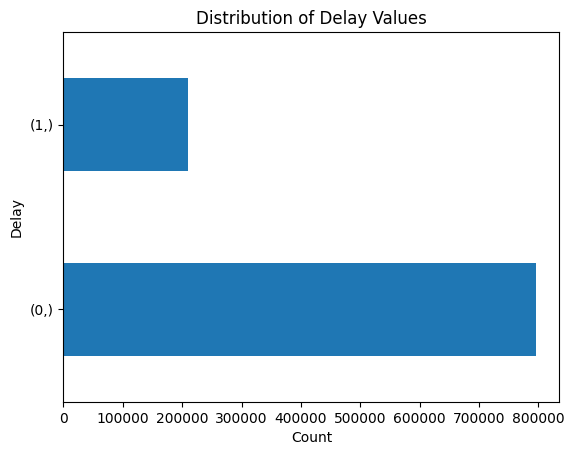

In [43]:
import matplotlib.pyplot as plt

value_counts = y.value_counts()
value_counts.plot(kind='barh')
plt.xlabel('Count')
plt.ylabel('Delay')
plt.title('Distribution of Delay Values')
plt.show()


### Creating new dataframe to use later for plotting correlation

In [45]:
df4 = pd.concat([df3,y],axis=1)

#### Data Splitting:

In [46]:
y = y.values.ravel()

=> Ravel changes multi-dimensional array into a continuous flattened array

In [47]:
# Splitting into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#### Model Selection - Random Forest

In [48]:
model_1 = 'random_forest_model.pkl'
if os.path.exists(model_1):
    loaded_model_1 = joblib.load(model_1)
else:
    rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
    rf_model.fit(X_train, y_train)
    joblib.dump(rf_model, model_1)

#### Model Evaluation:

In [49]:
# Predict on the testing set
pred_1 = loaded_model_1.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, pred_1)
report = classification_report(y_test, pred_1)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", report)


Accuracy: 0.9779066240346891
Classification Report:
               precision    recall  f1-score   support

           0       0.97      1.00      0.99    159113
           1       0.99      0.90      0.94     41988

    accuracy                           0.98    201101
   macro avg       0.98      0.95      0.97    201101
weighted avg       0.98      0.98      0.98    201101



#### Checking the first fifteen predicted and actual values

In [50]:
y_test[:15]

array([0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], dtype=int64)

In [51]:
pred_1[:15]

array([0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], dtype=int64)

#### Confusion Matrix

In [52]:
confusion_matrix(y_true=y_test,y_pred=pred_1)

array([[158861,    252],
       [  4191,  37797]], dtype=int64)

In [53]:
print(loaded_model_1.classes_) # By default the value is ([0,1])
cm = confusion_matrix(y_test,pred_1,labels=(1,0))
cm

[0 1]


array([[ 37797,   4191],
       [   252, 158861]], dtype=int64)

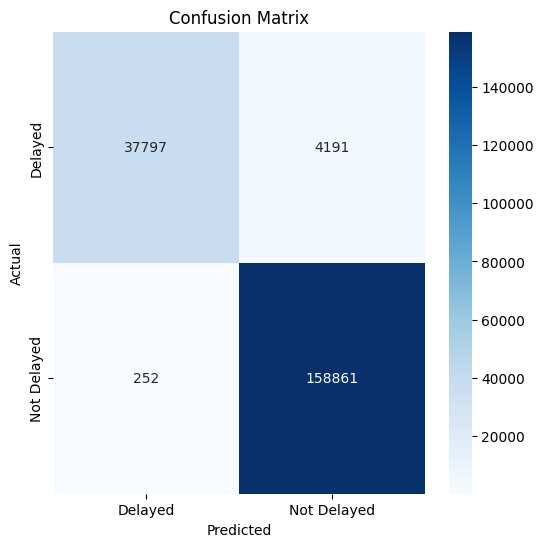

In [54]:
plt.figure(figsize=(6, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Delayed', 'Not Delayed'], yticklabels=['Delayed', 'Not Delayed'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [55]:
tp,fn,fp,tn = confusion_matrix(y_test,pred_1,labels=(1,0)).ravel()

=> saving the True Positives, False Negatives, False Positives and True Negatives


#### Correlation

In [56]:
df4_corr = df4[['MONTH', 'FLIGHT_NUMBER', 'DEPARTURE_TIME', 'ELAPSED_TIME', 'DISTANCE', 'Delay']].dropna().corr()
df4_corr

,MONTH,FLIGHT_NUMBER,DEPARTURE_TIME,ELAPSED_TIME,DISTANCE,Delay
MONTH,1.00,-0.01,-0.00,0.01,0.01,0.05
FLIGHT_NUMBER,-0.01,1.00,0.00,-0.32,-0.35,0.01
DEPARTURE_TIME,-0.00,0.00,1.00,-0.04,-0.02,0.22
ELAPSED_TIME,0.01,-0.32,-0.04,1.00,0.96,0.02
DISTANCE,0.01,-0.35,-0.02,0.96,1.00,0.01
Delay,0.05,0.01,0.22,0.02,0.01,1.00


#### Plotting a heatmap

<Axes: >

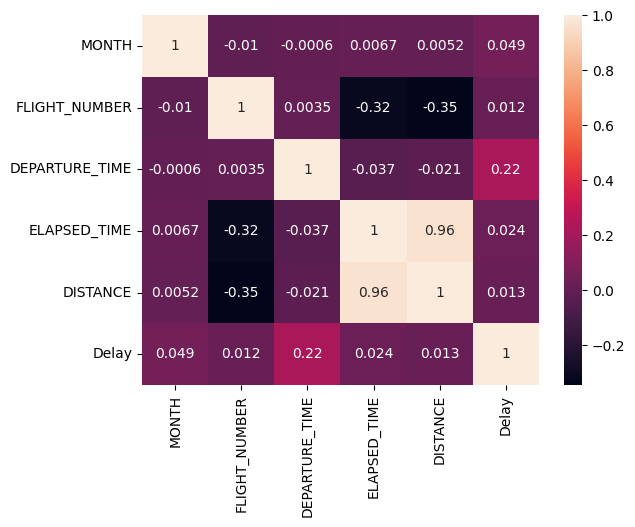

In [57]:
sns.heatmap(df4_corr,annot=True)

### Support Vector Machine

In [58]:
model_2 = 'svm_model.pkl'
if os.path.exists(model_2):
    loaded_model_2 = joblib.load(model_2)
else:
    svm_model = SVC(kernel='linear', random_state=44)
    svm_model.fit(X_train, y_train)
    joblib.dump(svm_model, model_2)

In [59]:
# Predict on the testing set
pred_2 = loaded_model_2.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, pred_2)
report = classification_report(y_test, pred_2)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", report)


Accuracy: 1.0
Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    159113
           1       1.00      1.00      1.00     41988

    accuracy                           1.00    201101
   macro avg       1.00      1.00      1.00    201101
weighted avg       1.00      1.00      1.00    201101



In [60]:
print(loaded_model_2.classes_) # By default the value is ([0,1])
cm2 = confusion_matrix(y_test,pred_2,labels=(1,0))
cm2

[0 1]


array([[ 41988,      0],
       [     0, 159113]], dtype=int64)

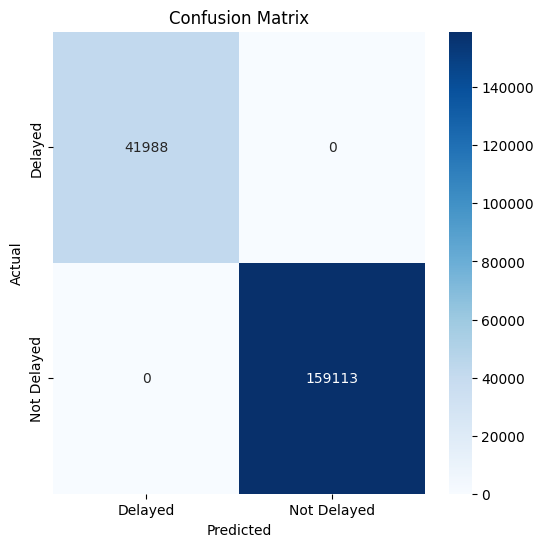

In [61]:
# Plotting the confusion matrix
plt.figure(figsize=(6, 6))
sns.heatmap(cm2, annot=True, fmt='d', cmap='Blues', xticklabels=['Delayed', 'Not Delayed'], yticklabels=['Delayed', 'Not Delayed'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [62]:
df4['Delay'].value_counts()

Delay
0    795593
1    209911
Name: count, dtype: int64

In [63]:
0.2 * 795593

159118.6

In [64]:
0.2 * 209911

41982.200000000004

### Logistic Regression

In [65]:
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [66]:
model_3 = 'lr_model.pkl'
if os.path.exists(model_3):
    loaded_model_3 = joblib.load(model_3)
else:
    logreg_model = LogisticRegression(max_iter=4000) 
    logreg_model.fit(X_train_scaled, y_train)
    joblib.dump(logreg_model, model_3)
    

In [67]:
# Predict on the testing set
pred_3 = loaded_model_3.predict(X_test_scaled)

# Evaluate the model
accuracy = accuracy_score(y_test, pred_3)
report = classification_report(y_test, pred_3)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", report)


Accuracy: 0.9999254106145669
Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    159113
           1       1.00      1.00      1.00     41988

    accuracy                           1.00    201101
   macro avg       1.00      1.00      1.00    201101
weighted avg       1.00      1.00      1.00    201101



In [68]:
print(loaded_model_3.classes_) # By default the value is ([0,1])

# changing the way the labels are represented
cm3 = confusion_matrix(y_test,pred_3,labels=(1,0)) 
cm3

[0 1]


array([[ 41974,     14],
       [     1, 159112]], dtype=int64)

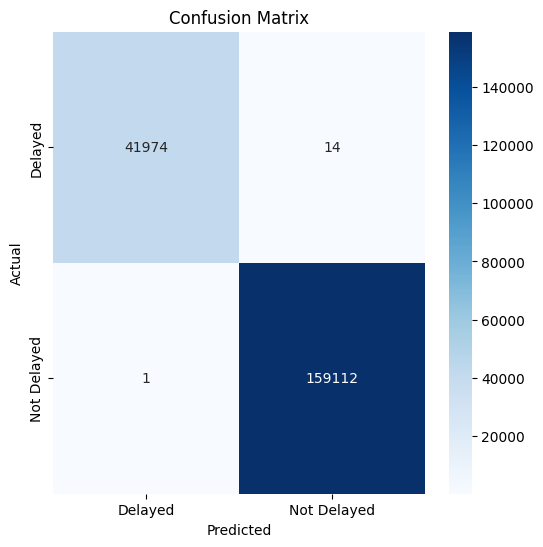

In [69]:
# Plotting the confusion matrix
plt.figure(figsize=(6, 6))
sns.heatmap(cm3, annot=True, fmt='d', cmap='Blues', xticklabels=['Delayed', 'Not Delayed'], yticklabels=['Delayed', 'Not Delayed'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()